In [1]:
def identify_body_part(x, y):
    """
    Identify the body part based on the x and y coordinates of the click.

    Parameters:
    x (int): The x-coordinate of the click.
    y (int): The y-coordinate of the click.

    Returns:
    str: Name of the body part corresponding to the clicked coordinates.
    """

    # Front View (Left half of the image)
    if 0 <= x < 300:
        # Head
        if 0 <= y <= 100:
            return "Head (Front)"
        # Shoulders
        elif 100 <= y <= 150:
            return "Left Shoulder (Front)" if x < 150 else "Right Shoulder (Front)"
        # Chest
        elif 150 <= y <= 200:
            return "Chest"
        # Abdomen
        elif 200 <= y <= 300:
            return "Abdomen"
        # Arms
        elif 150 <= y <= 400:
            return "Left Arm (Front)" if x < 75 else "Right Arm (Front)" if x > 225 else None
        # Hips
        elif 300 <= y <= 350:
            return "Hips"
        # Legs
        elif 350 <= y <= 587:
            return "Left Leg (Front)" if x < 150 else "Right Leg (Front)"

    # Back View (Right half of the image)
    elif 310 <= x < 610:
        # Head (Back)
        if 0 <= y <= 100:
            return "Head (Back)"
        # Shoulders (Back)
        elif 100 <= y <= 150:
            return "Left Shoulder (Back)" if x < 410 else "Right Shoulder (Back)"
        # Upper Back
        elif 150 <= y <= 250:
            return "Upper Back"
        # Middle Back
        elif 250 <= y <= 350:
            return "Middle Back"
        # Lower Back
        elif 350 <= y <= 400:
            return "Lower Back"
        # Arms (Back)
        elif 150 <= y <= 400:
            return "Left Arm (Back)" if x < 360 else "Right Arm (Back)" if x > 500 else None
        # Glutes
        elif 400 <= y <= 450:
            return "Glutes"
        # Legs (Back)
        elif 450 <= y <= 587:
            return "Left Leg (Back)" if x < 450 else "Right Leg (Back)"

    # If click is outside of defined regions
    return "Unknown Area"


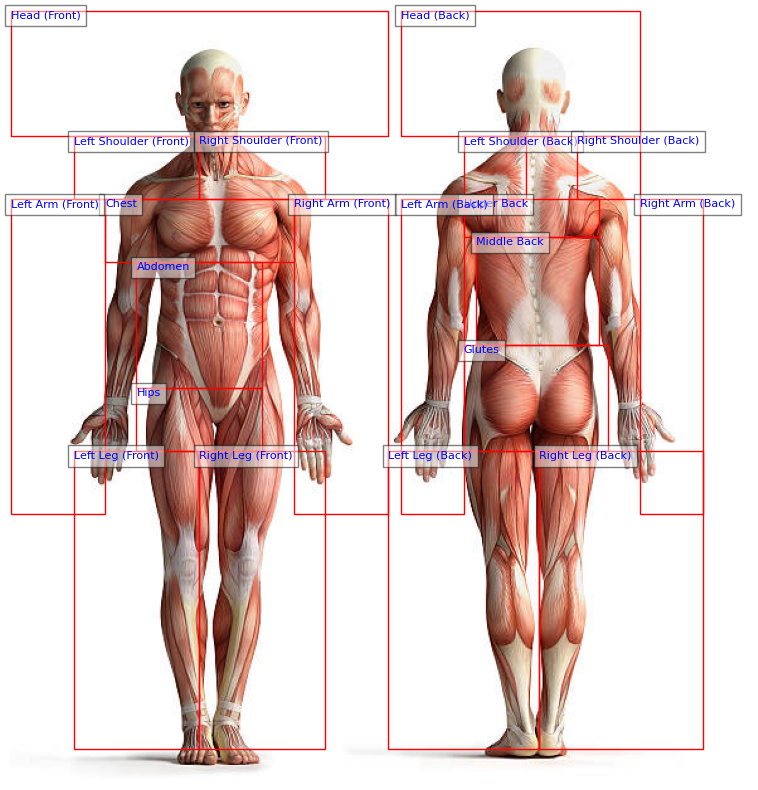

In [34]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg

# Load the image
image_path = "/Users/jainilpatel/PycharmProjects/Exercise-Correction/web/server/static/assets/skeleton.jpg"
img = mpimg.imread(image_path)

# Define coordinates for each body part region in terms of (x_min, y_min, x_max, y_max)
body_parts = {
    "Head (Front)": (0, 0, 300, 100),
    "Left Shoulder (Front)": (50, 100, 150, 150),
    "Right Shoulder (Front)": (150, 100, 250, 150),
    "Chest": (75, 150, 225, 200),
    "Abdomen": (100, 200, 200, 300),
    "Left Arm (Front)": (0, 150, 75, 400),
    "Right Arm (Front)": (225, 150, 300, 400),
    "Hips": (100, 300, 200, 350),
    "Left Leg (Front)": (50, 350, 150, 587),
    "Right Leg (Front)": (150, 350, 250, 587),
    
    "Head (Back)": (310, 0, 500, 100),
    "Left Shoulder (Back)": (360, 100, 410, 150),
    "Right Shoulder (Back)": (450, 100, 500, 150),
    "Upper Back": (360, 150, 468, 180),
    "Middle Back": (370, 180, 468, 266),
    "Left Arm (Back)": (310, 150, 360, 400),
    "Right Arm (Back)": (500, 150, 550, 400),
    "Glutes": (360, 266, 475, 350),
    "Left Leg (Back)": (300, 350, 420, 587),
    "Right Leg (Back)": (420, 350, 550, 587)
}

# Function to display coordinates
def on_mouse_move(event):
    if event.inaxes:
        # Display the x and y coordinates of the mouse pointer in the title of the figure
        x, y = int(event.xdata), int(event.ydata)
        fig.suptitle(f"Mouse coordinates: x={x}, y={y}", fontsize=12)

# Function to handle clicks and print coordinates
def on_click(event):
    if event.inaxes:
        x, y = int(event.xdata), int(event.ydata)
        print(f"Selected coordinates: x={x}, y={y}")

# Plotting
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(img)

# Draw rectangles around each defined area and add labels
for part, (x_min, y_min, x_max, y_max) in body_parts.items():
    # Create a rectangle
    rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                             linewidth=1, edgecolor='red', facecolor='none')
    ax.add_patch(rect)
    # Add label
    plt.text(x_min, y_min, part, color='blue', fontsize=8, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

plt.axis('off')  # Hide axes

# Connect the event handlers to the figure
fig.canvas.mpl_connect('motion_notify_event', on_mouse_move)
fig.canvas.mpl_connect('button_press_event', on_click)

plt.show()


In [28]:
import plotly.graph_objects as go
import numpy as np
import matplotlib.image as mpimg

# Load the image
image_path = "/Users/jainilpatel/PycharmProjects/Exercise-Correction/web/server/static/assets/skeleton.jpg"
img = mpimg.imread(image_path)

# Create the plotly figure
fig = go.Figure()

# Add the image
fig.add_trace(go.Image(z=img))

# Set the layout to show hover coordinates
fig.update_layout(
    title="Hover to see coordinates, click to log coordinates",
    xaxis=dict(showgrid=False, visible=False),
    yaxis=dict(showgrid=False, visible=False, scaleanchor="x", scaleratio=1),
)

# Initialize empty list to store clicked coordinates
clicked_points = []

# Add a click event to capture coordinates
fig.update_layout(
    clickmode='event+select'
)

# Event handler for capturing click data
def on_click(trace, points, state):
    # Access x and y coordinates
    for point in points.point_inds:
        x = points.xs[point]
        y = points.ys[point]
        clicked_points.append((x, y))
        print(f"Selected coordinates: x={x}, y={y}")

# Attach the click event handler
fig.data[0].on_click(on_click)

# Show the figure
fig.show()
